In [16]:
import logging, math
from pathlib import Path

import torch

import matplotlib.pyplot as plt
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler, StableDiffusionPipeline
from huggingface_hub import notebook_login
from PIL import Image

from tqdm.auto import tqdm

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

device = "cuda"

In [17]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16).to("cuda")
#pipe.enable_attention_slicing()

Fetching 16 files: 100%|██████████| 16/16 [00:00<00:00, 5335.84it/s]


100%|██████████| 50/50 [00:08<00:00,  6.15it/s]


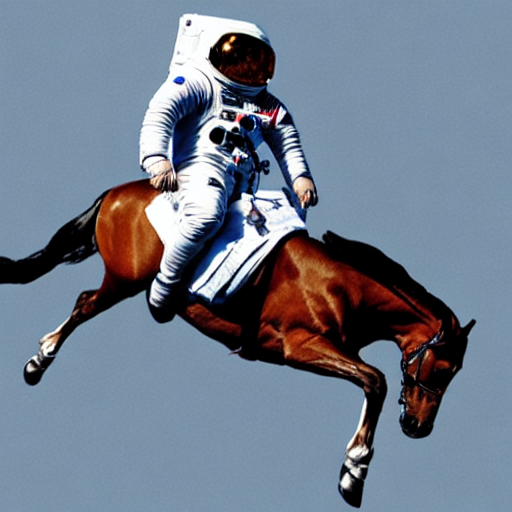

In [18]:
torch.manual_seed(1024)
prompt = "a photograph of an astronaut riding a horse"
pipe(prompt).images[0]

In [19]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [20]:
vae = pipe.vae
images = []

def latents_callback(i, t, latents):
    # print("i: " + str(i))
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample[0]
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))

torch.manual_seed(1023)
final_image = pipe(prompt, callback=latents_callback, callback_steps=1).images[0]
images.append(final_image)

100%|██████████| 50/50 [00:18<00:00,  2.74it/s]


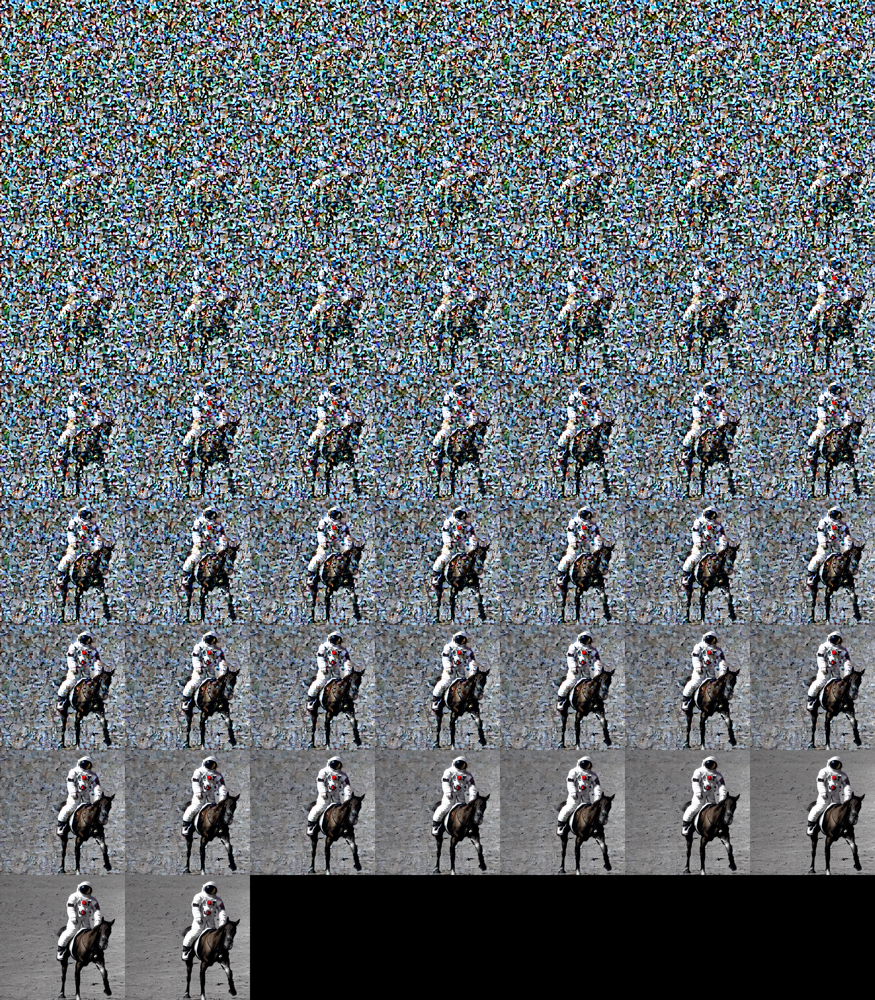

In [21]:

rows = math.ceil((len(images))**(1/2))
image_grid(images, rows=rows, cols=math.ceil(len(images)/rows))